<h1 align="center"><a href="https://github.com/sborquez/gerumo/">*</a> GeRUMo - Gamma-ray Events Reconstructor with Uncertain models</h1>

<h2 align="center">Prepare Preprocessing</h2>

<center>
<img src="https://upload.wikimedia.org/wikipedia/commons/2/2f/Cta_concept.jpg" width="30%" alt="icon"></img>
</center>

## Setup

The first step is to sync this notebook with Google Drive, and change directory to gerumo repository.

#### Colab Setup

In [ ]:
!pip install -q ctaplot

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

In [ ]:
%cd "/content/drive/My Drive/Projects/gerumo"
!ls

#### Local Setup

In [1]:
%cd /mnt/d/sebas/Google Drive/Projects/gerumo

/mnt/d/sebas/Google Drive/Projects/gerumo


## Load Gerumo and extra modules.

In [2]:
from gerumo import *

import json
import time
from os import path
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import pprint
import ctaplot
import ctapipe
from joblib import dump, load
from sklearn.preprocessing import MinMaxScaler, RobustScaler
from ctapipe.image import tailcuts_clean, dilate

## Data Generator

In [23]:
config_file = "/mnt/d/sebas/Google Drive/Projects/gerumo/train/config/local/alt_az/bmo_mst_local.json"

In [24]:
print(f"Loading config from: {config_file}")
with open(config_file) as cfg_file:
    config = json.load(cfg_file)

# Dataset Parameters
version                   = config["version"]
replace_folder_train      = config["replace_folder_train"]
replace_folder_validation = config["replace_folder_validation"]
train_events_csv          = config["train_events_csv"]
train_telescope_csv       = config["train_telescope_csv"]
validation_events_csv     = config["validation_events_csv"]
validation_telescope_csv  = config["validation_telescope_csv"]


# read only pixels values. 
input_image_mode = "raw"
input_features   =  config["input_features"]

Loading config from: /mnt/d/sebas/Google Drive/Projects/gerumo/train/config/local/alt_az/bmo_mst_local.json


In [29]:
# Load and aggregate dataset
train_dataset = load_dataset(train_events_csv, train_telescope_csv, replace_folder_train)
train_dataset = aggregate_dataset(train_dataset, az=True, log10_mc_energy=True)

print("Dataset description")
describe_dataset(train_dataset)

# Filter LST observations
LST_train_dataset = filter_dataset(train_dataset, "LST_LSTCam", 0)
LST_generator = AssemblerUnitGenerator(LST_train_dataset, 1, 
                                        input_image_mode=input_image_mode, 
                                        input_image_mask=None, 
                                        input_features=input_features,
                                        targets=None,
                                        target_mode=None, 
                                        target_mode_config=None,
                                        version=version
                                        )
# Filter MST observations
MST_train_dataset = filter_dataset(train_dataset, "MST_FlashCam", 0)
MST_generator = AssemblerUnitGenerator(MST_train_dataset, 1, 
                                        input_image_mode=input_image_mode, 
                                        input_image_mask=None, 
                                        input_features=input_features,
                                        targets=None,
                                        target_mode=None, 
                                        target_mode_config=None,
                                        version=version
                                        )
# Filter SST observations
SST_train_dataset = filter_dataset(train_dataset, "SST1M_DigiCam", 0)
SST_generator = AssemblerUnitGenerator(SST_train_dataset, 1, 
                                        input_image_mode=input_image_mode, 
                                        input_image_mask=None, 
                                        input_features=input_features,
                                        targets=None,
                                        target_mode=None, 
                                        target_mode_config=None,
                                        version=version
                                        )

Dataset description
files 19
events 20799
observations 79609
obsevation by telescopes
MST_FlashCam     42646
SST1M_DigiCam    26849
LST_LSTCam       10114
Name: type, dtype: int64


## Image Cleaning

In [30]:
#handcrafted parameters
tailcuts_clean_parameters = {
    "LST_LSTCam"   :  {"picture_thresh":5, "boundary_thresh": 3},
    "MST_FlashCam" :  {"picture_thresh":14, "boundary_thresh":6},
    "SST_DigiCam": {"picture_thresh":4, "boundary_thresh": 2}
}


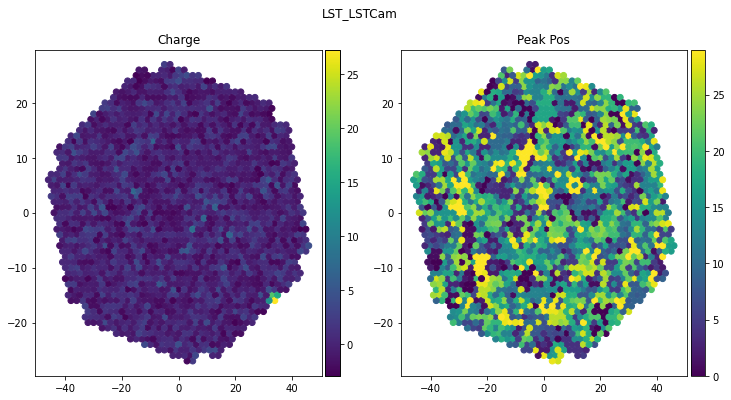

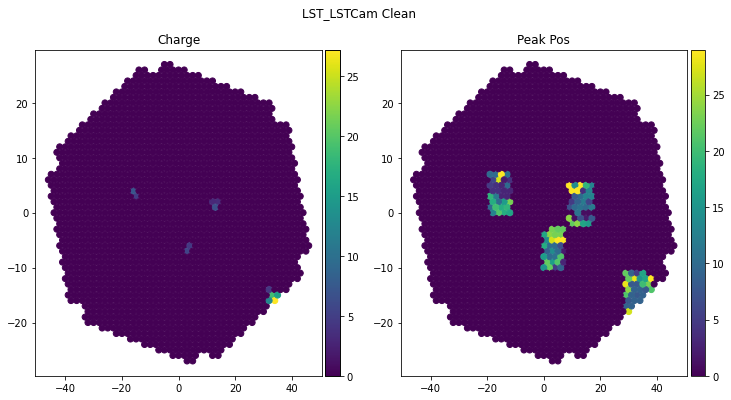

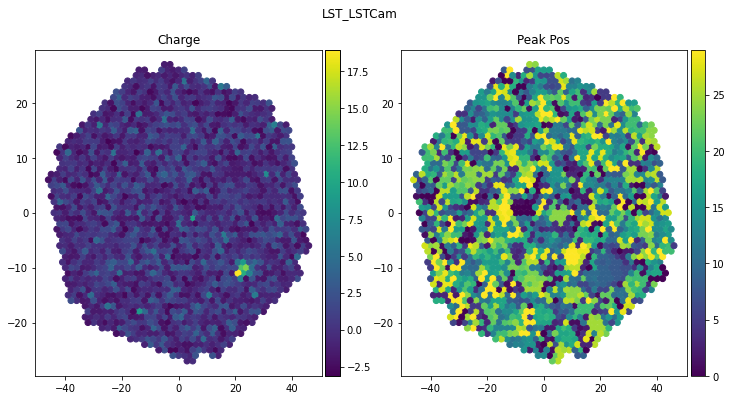

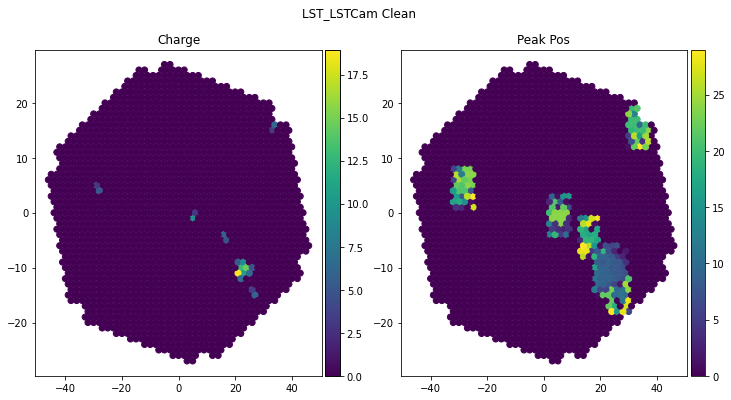

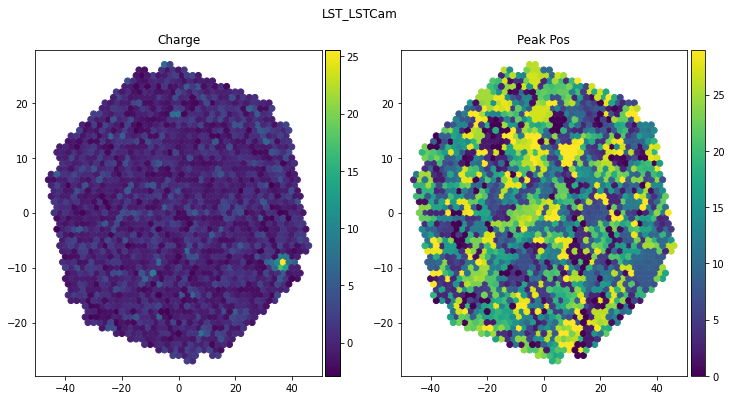

...

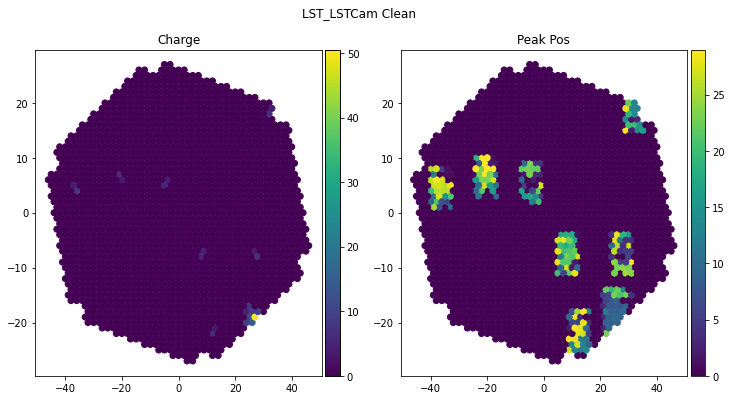

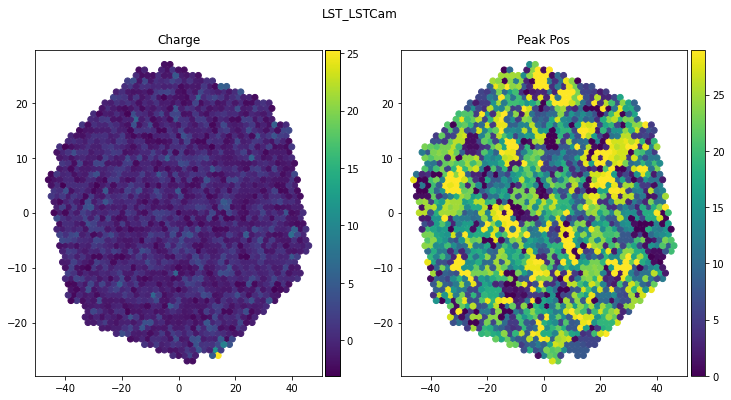

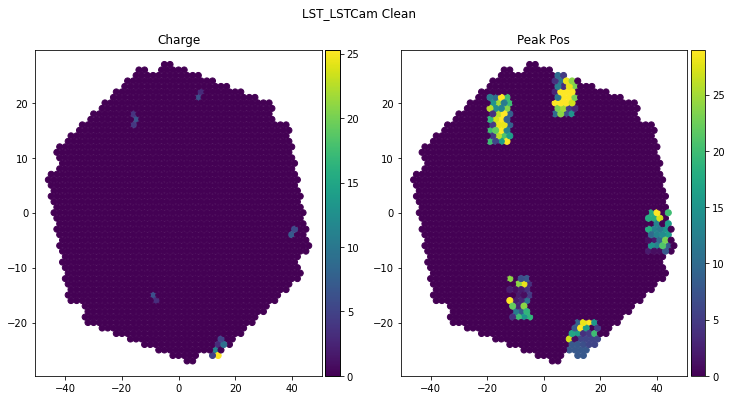

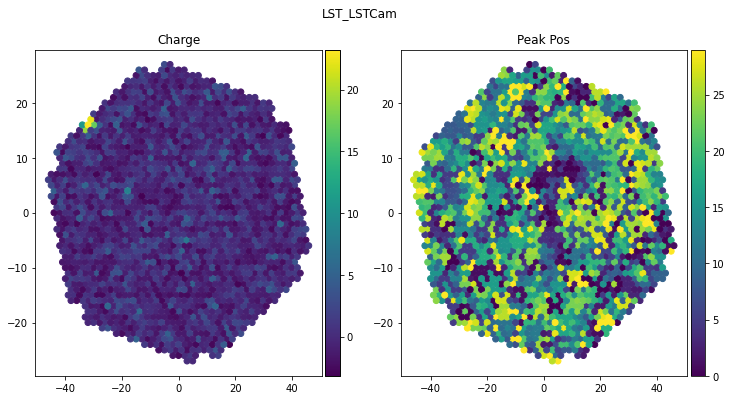

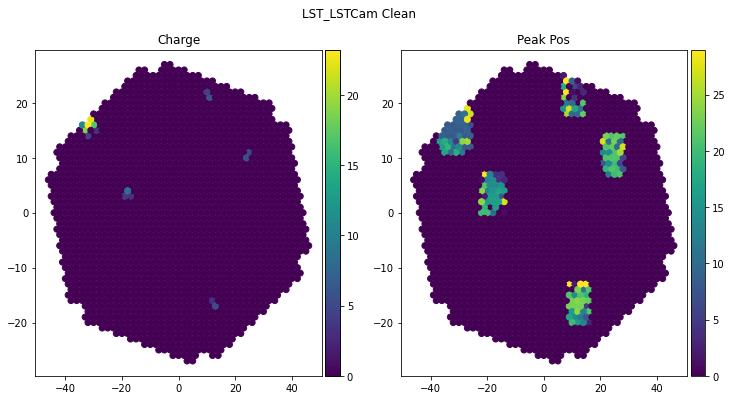

In [31]:
# Load camera's geometry (pixel positions)
geometry = load_camera_geometry("LST_LSTCam",  version)

# Save pixels values of all dataset
LST_charges = []
LST_peaks   = []
for i, d in enumerate(LST_generator):
    # load pixel values
    charge, peak = d[0][0][0]
    LST_peaks.append(peak.copy())
    # clean image (charge)
    cleanmask = tailcuts_clean(geometry, charge, picture_thresh=5, boundary_thresh=3)
    copy_charge = charge.copy()
    copy_charge[~cleanmask] = 0.0
    #dilate and clean image (time peaks)
    for _ in range(3):
        cleanmask = dilate(geometry, cleanmask)
    copy_peak = peak.copy()
    copy_peak[~cleanmask] = 0.0
    
    LST_charges.append(copy_charge.copy())
    if i <= 15:
        pixpos = PIXELS_POSITION[version]['raw']["LST_LSTCam"]
        plot_observation_scatter(charge, peak, pixpos, "LST_LSTCam")
        plot_observation_scatter(copy_charge, copy_peak, pixpos, "LST_LSTCam Clean")

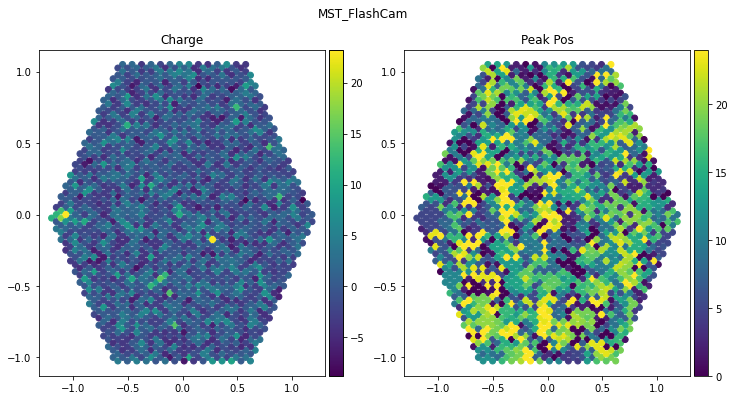

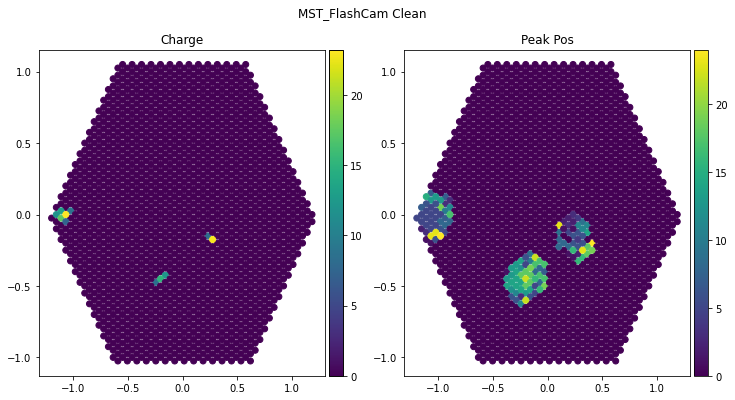

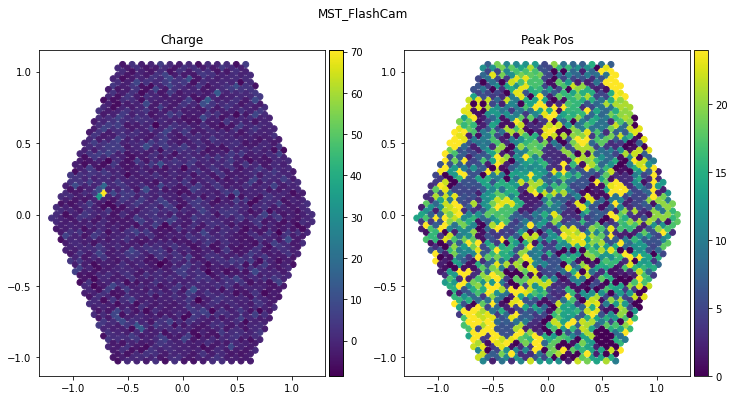

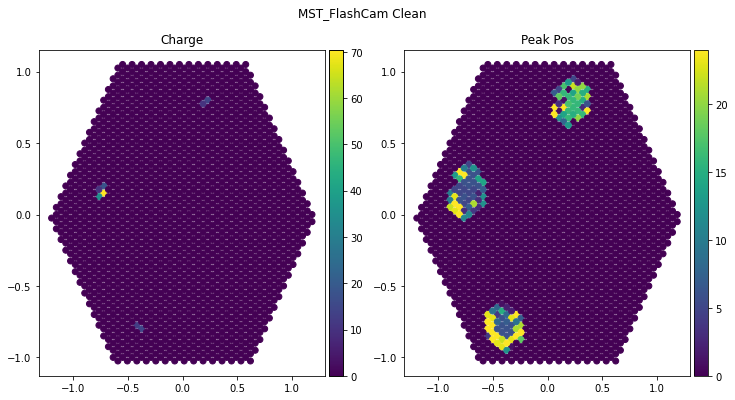

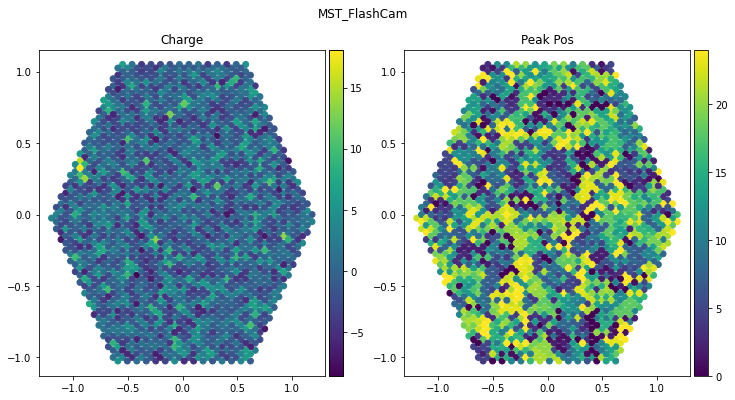

...

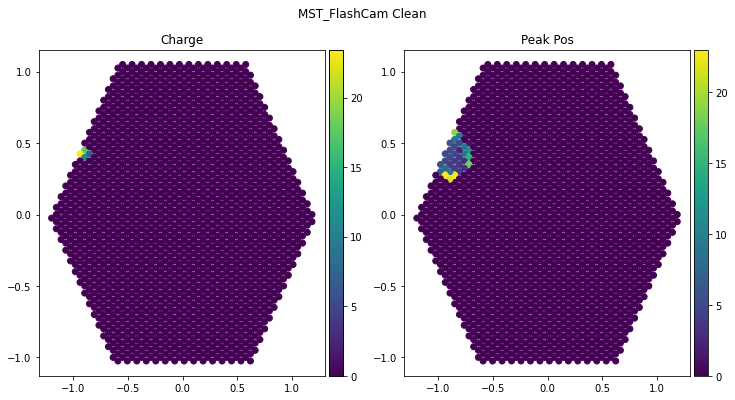

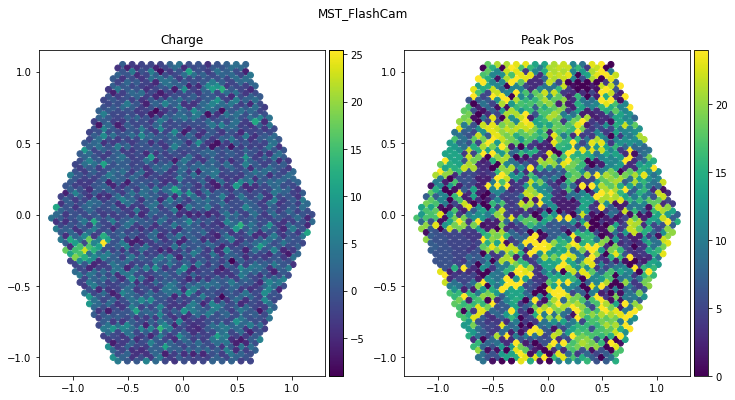

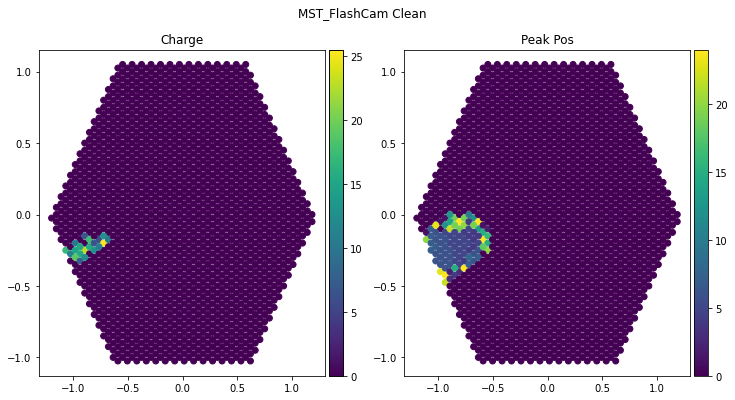

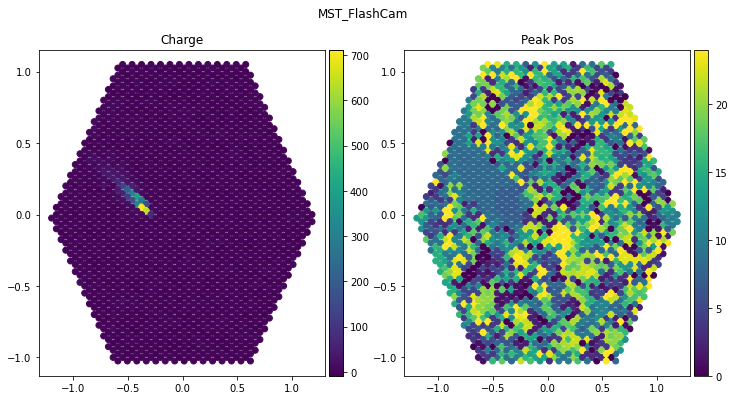

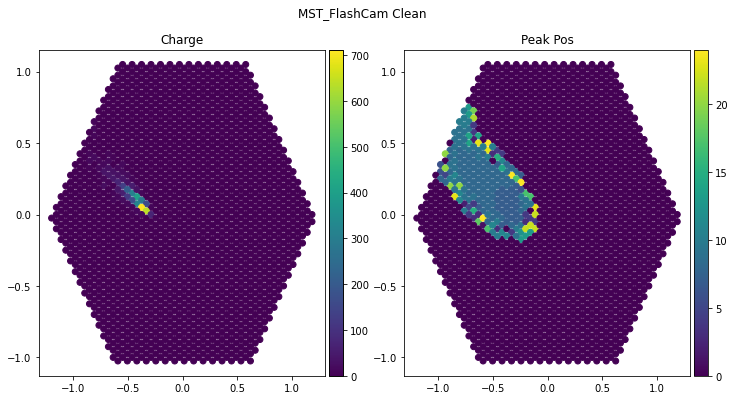

In [32]:
# Load camera's geometry (pixel positions)
geometry = load_camera_geometry("MST_FlashCam",  version)

# Save pixels values of all dataset
MST_charges = []
MST_peaks   = []
for i, d in enumerate(MST_generator):
    # load pixel values
    charge, peak = d[0][0][0]
    MST_peaks.append(peak.copy())
    # clean image (charge)
    cleanmask = tailcuts_clean(geometry, charge, picture_thresh=14, boundary_thresh=6)
    copy_charge = charge.copy()
    copy_charge[~cleanmask] = 0.0
    #dilate and clean image (time peaks)
    for _ in range(3):
        cleanmask = dilate(geometry, cleanmask)
    copy_peak = peak.copy()
    copy_peak[~cleanmask] = 0.0
    MST_charges.append(copy_charge.copy())
    if i <= 15:
        pixpos = PIXELS_POSITION[version]['raw']["MST_FlashCam"]
        plot_observation_scatter(charge, peak, pixpos, "MST_FlashCam")
        plot_observation_scatter(copy_charge, copy_peak, pixpos, "MST_FlashCam Clean")

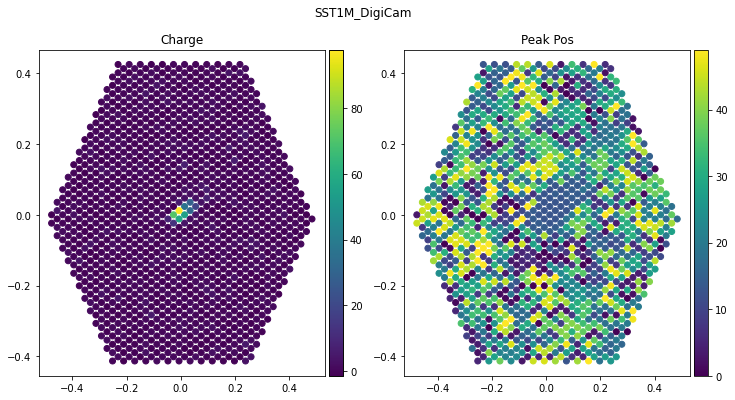

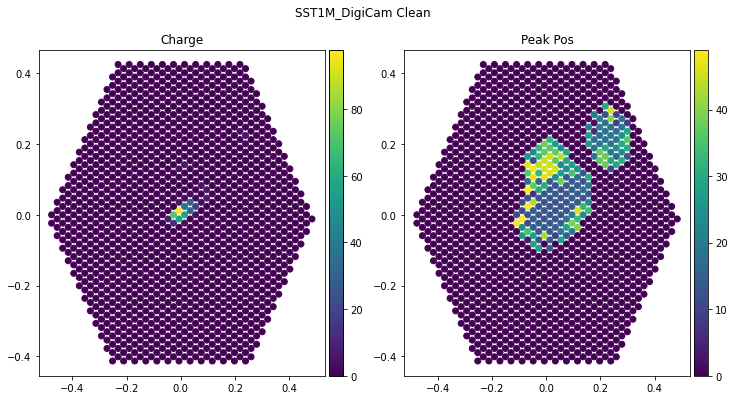

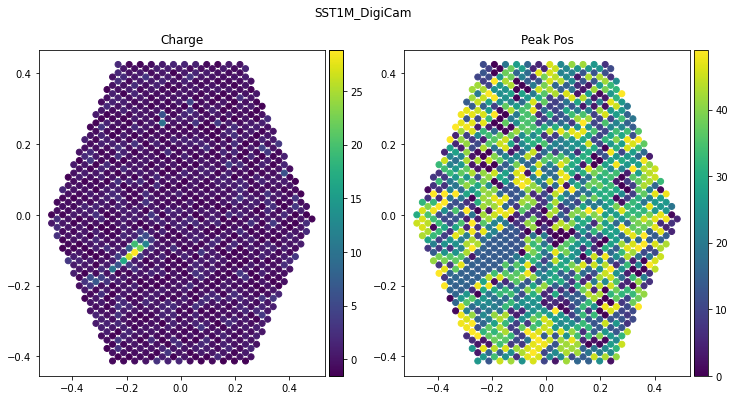

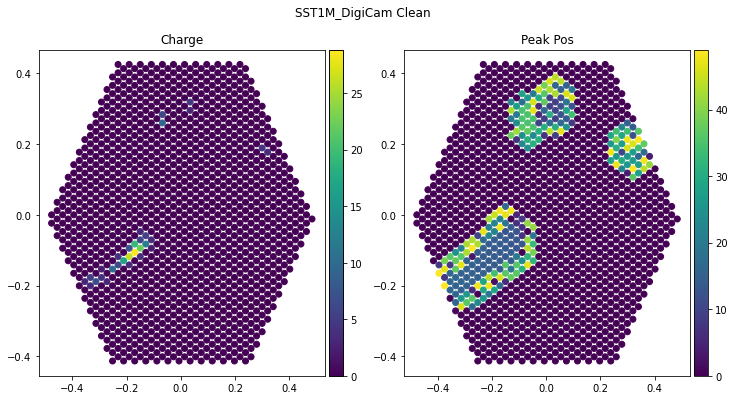

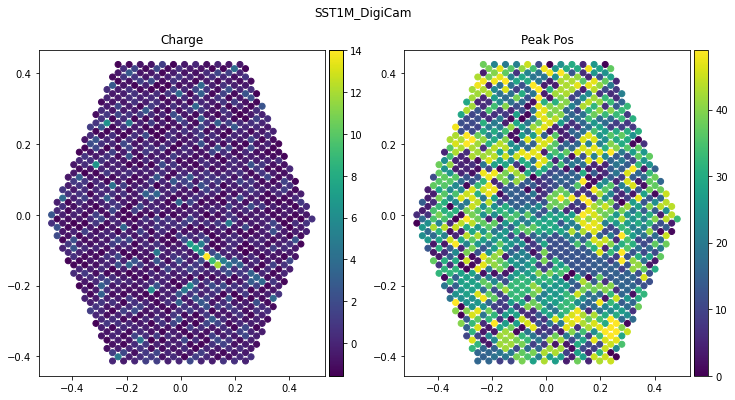

...

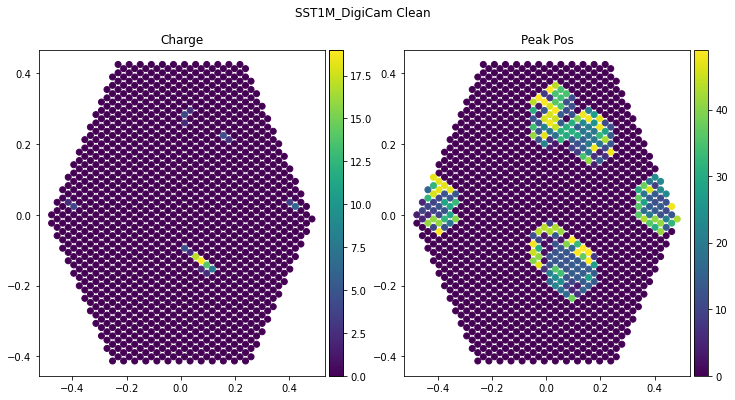

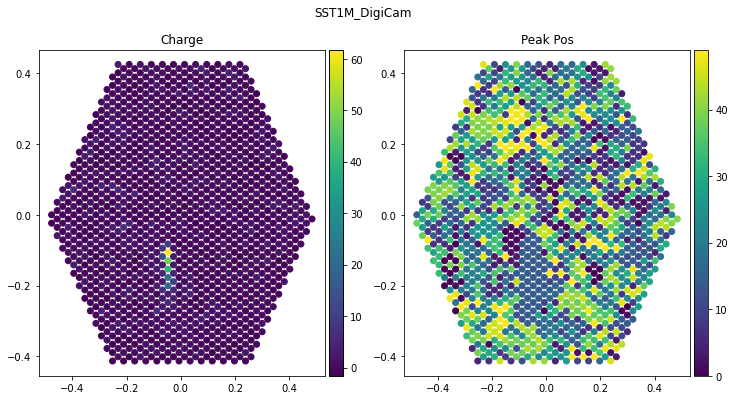

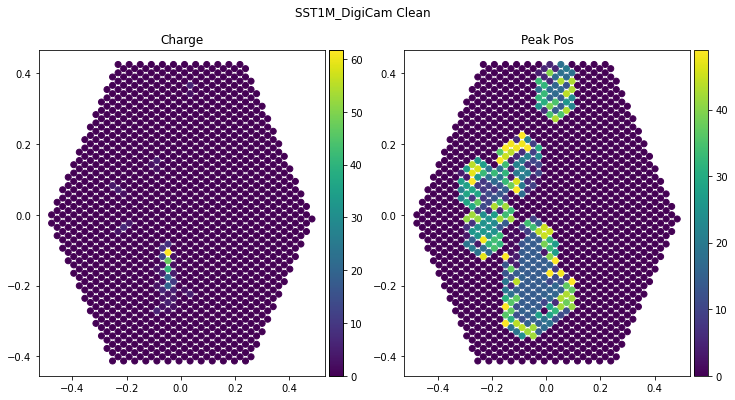

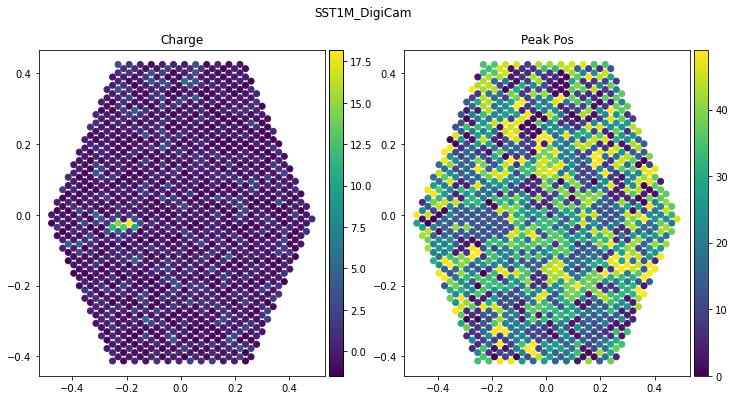

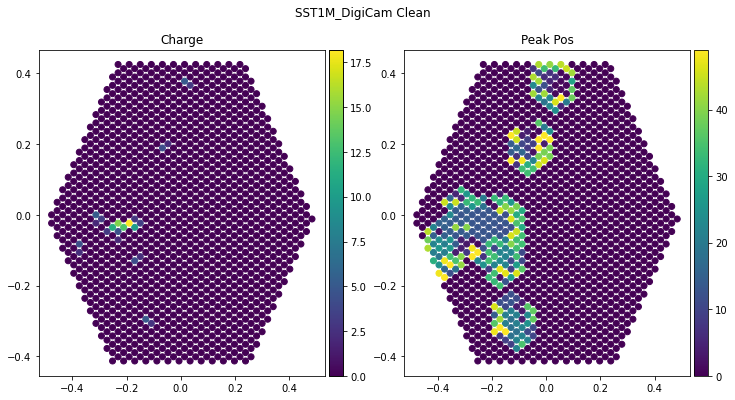

In [33]:
# Load camera's geometry (pixel positions)
geometry = load_camera_geometry("SST1M_DigiCam",  version)

# Save pixels values of all dataset
SST_charges = []
SST_peaks   = []
for i, d in enumerate(SST_generator):
    # load pixel values
    charge, peak = d[0][0][0]
    SST_peaks.append(peak.copy())
    # clean image (charge)
    cleanmask = tailcuts_clean(geometry, charge, picture_thresh=4, boundary_thresh=2)
    copy_charge = charge.copy()
    copy_charge[~cleanmask] = 0.0
    #dilate and clean image (time peaks)
    for _ in range(3):
        cleanmask = dilate(geometry, cleanmask)
    copy_peak = peak.copy()
    copy_peak[~cleanmask] = 0.0
    SST_charges.append(copy_charge.copy())
    if i < 15:
        pixpos = PIXELS_POSITION[version]['raw']["SST1M_DigiCam"]
        plot_observation_scatter(charge, peak, pixpos, "SST1M_DigiCam")
        plot_observation_scatter(copy_charge, copy_peak, pixpos, "SST1M_DigiCam Clean")

### Charge

In [34]:
LST_charges_arr = np.array(LST_charges)
MST_charges_arr = np.array(MST_charges)
SST_charges_arr = np.array(SST_charges)

209.56702 0.0


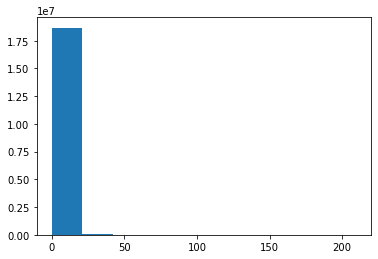

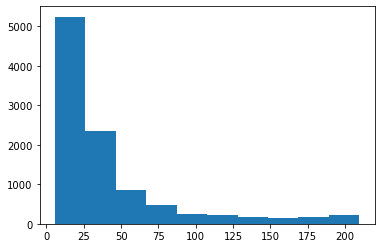

36.852122955322265


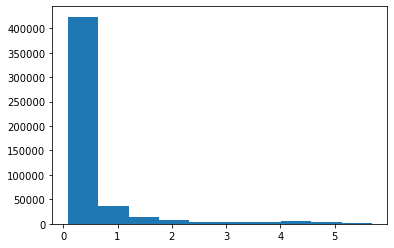

In [43]:
print(LST_charges_arr.max(), LST_charges_arr.min())
plt.hist(LST_charges_arr.flatten());plt.show()

plt.hist(LST_charges_arr.max(axis=1)); plt.show()
lst_percentile = np.percentile(LST_charges_arr.max(axis=1), 68)
print(lst_percentile)
plt.hist(LST_charges_arr.flatten()[LST_charges_arr.flatten() > 0]/lst_percentile); plt.show()

9973.838 0.0


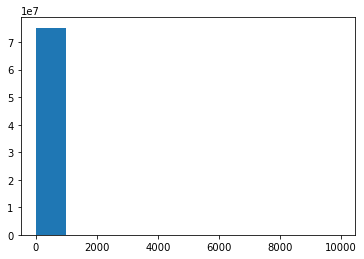

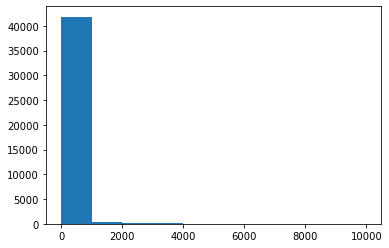

64.38580017089845


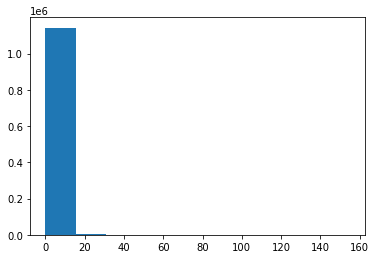

In [41]:
print(MST_charges_arr.max(), MST_charges_arr.min())
plt.hist(MST_charges_arr.flatten());plt.show()

plt.hist(MST_charges_arr.max(axis=1)); plt.show()
mst_percentile = np.percentile(MST_charges_arr.max(axis=1), 68)
print(mst_percentile)
plt.hist(MST_charges_arr.flatten()[MST_charges_arr.flatten() > 0]/mst_percentile); plt.show()

6060.9683 0.0


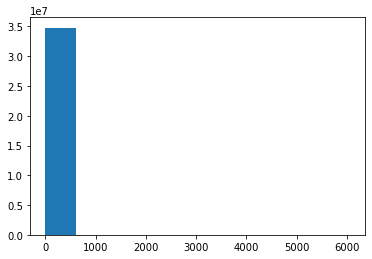

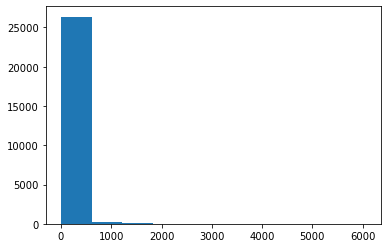

39.223409118652356


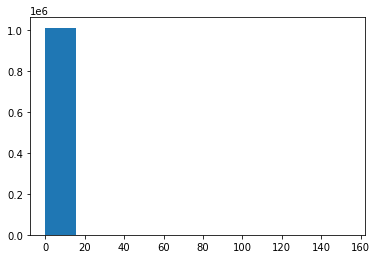

In [42]:
print(SST_charges_arr.max(), SST_charges_arr.min())
plt.hist(SST_charges_arr.flatten());plt.show()

plt.hist(SST_charges_arr.max(axis=1)); plt.show()
sst_percentile = np.percentile(SST_charges_arr.max(axis=1), 68)
print(sst_percentile)
plt.hist(SST_charges_arr.flatten()[SST_charges_arr.flatten() > 0]/sst_percentile); plt.show()

### Peak



In [44]:
from sklearn.preprocessing import MinMaxScaler

LST_peaks = np.array(LST_peaks).flatten().reshape((-1, 1))
MST_peaks = np.array(MST_peaks).flatten().reshape((-1, 1))
SST_peaks = np.array(SST_peaks).flatten().reshape((-1, 1))

In [45]:
lst_scaler = MinMaxScaler().fit(LST_peaks)
mst_scaler = MinMaxScaler().fit(MST_peaks)
sst_scaler = MinMaxScaler().fit(SST_peaks)

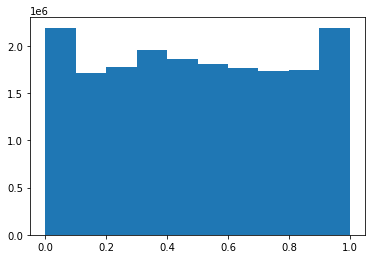

In [46]:
plt.hist(lst_scaler.transform(LST_peaks));

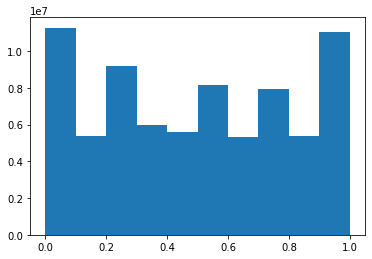

In [47]:
plt.hist(mst_scaler.transform(MST_peaks));

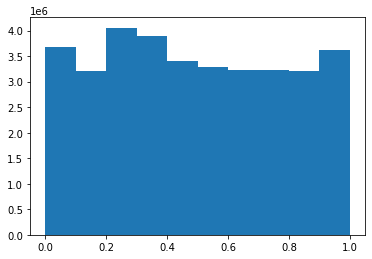

In [49]:
plt.hist(sst_scaler.transform(SST_peaks));

#### Applied

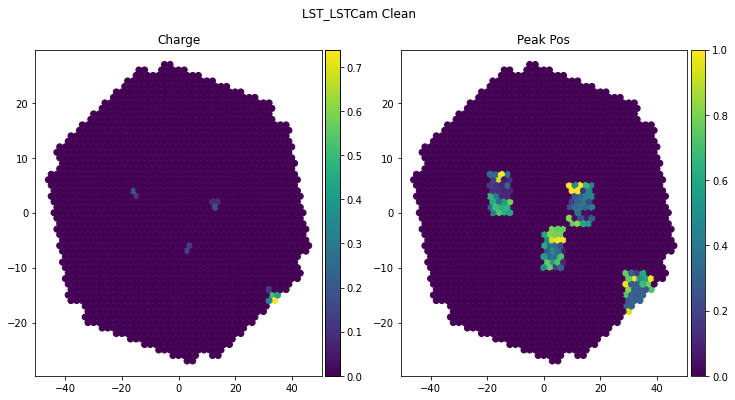

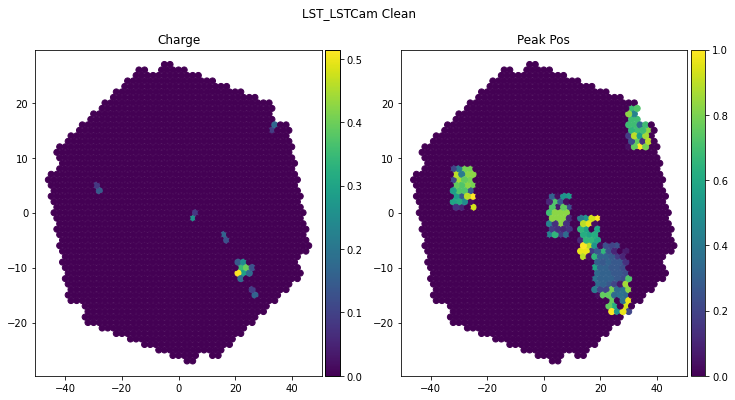

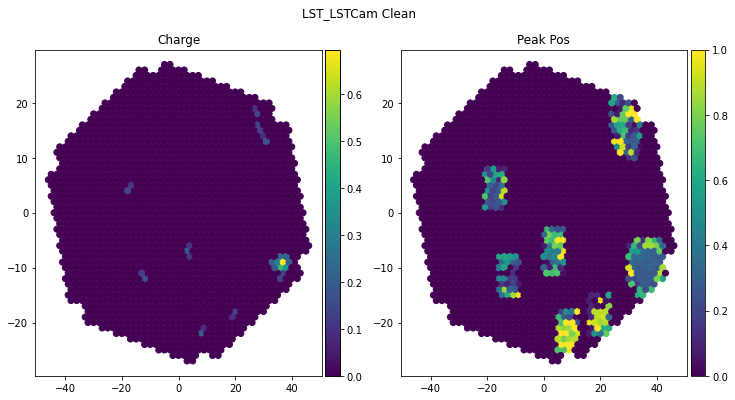

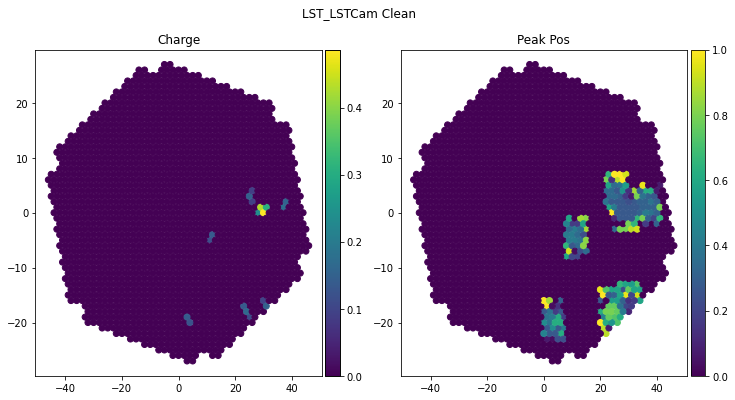

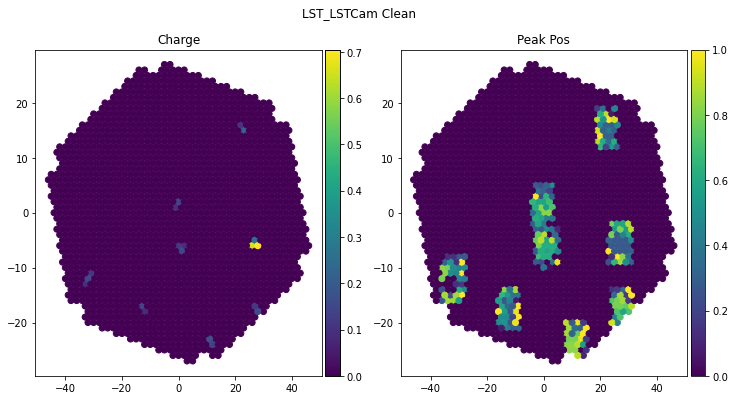

...

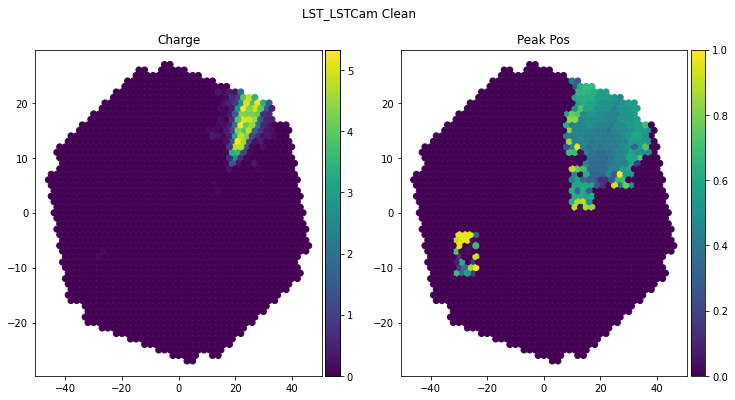

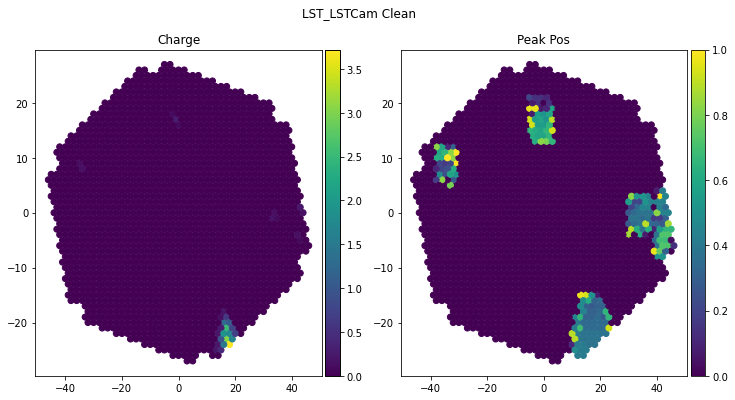

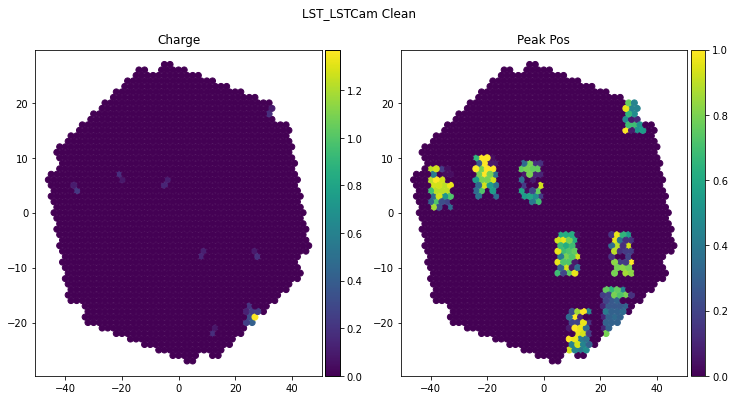

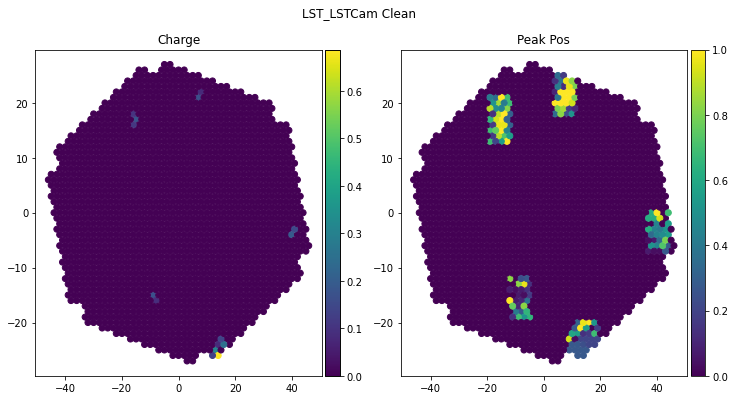

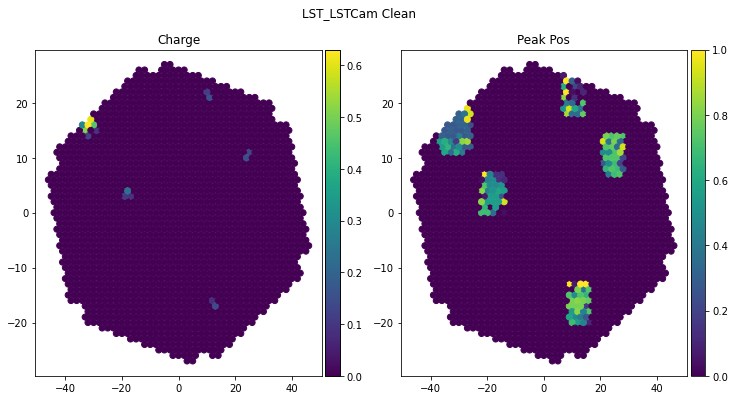

In [50]:
geometry = load_camera_geometry("LST_LSTCam",  version)
for i, d in enumerate(LST_generator):
    charge, peak = d[0][0][0]
    pixpos = PIXELS_POSITION[version]['raw']["LST_LSTCam"]
    cleanmask = tailcuts_clean(geometry, charge, picture_thresh=5, boundary_thresh=3)
    copy_charge = charge.copy()
    copy_charge[~cleanmask] = 0.0
    for _ in range(3):
        cleanmask = dilate(geometry, cleanmask)
    copy_peak = peak.copy()
    copy_peak[~cleanmask] = 0.0    
    if i <= 15:
        plot_observation_scatter(copy_charge/lst_percentile, lst_scaler.transform(copy_peak.reshape((-1,1))).flatten(), pixpos, "LST_LSTCam Clean")

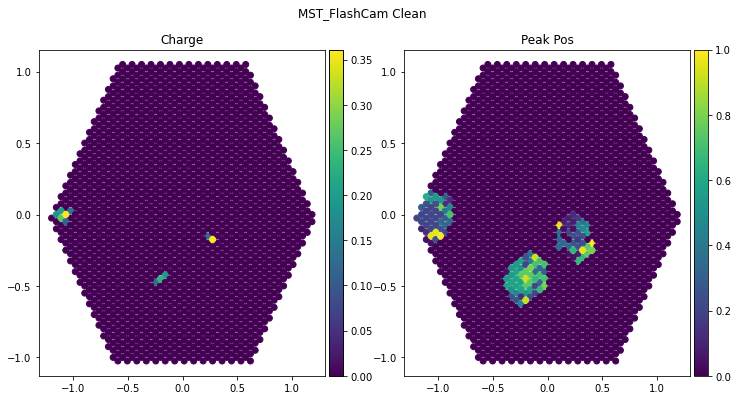

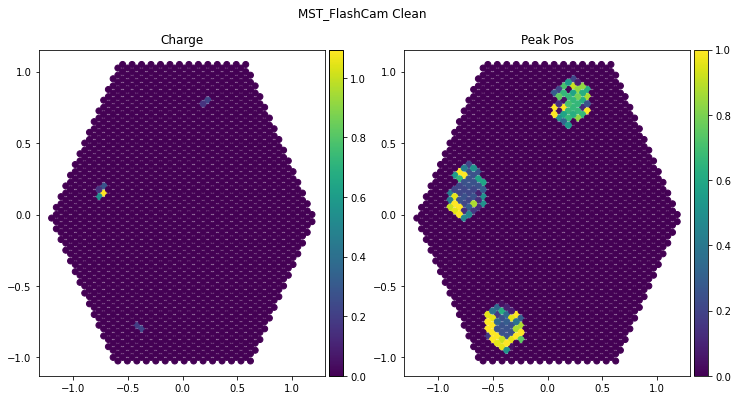

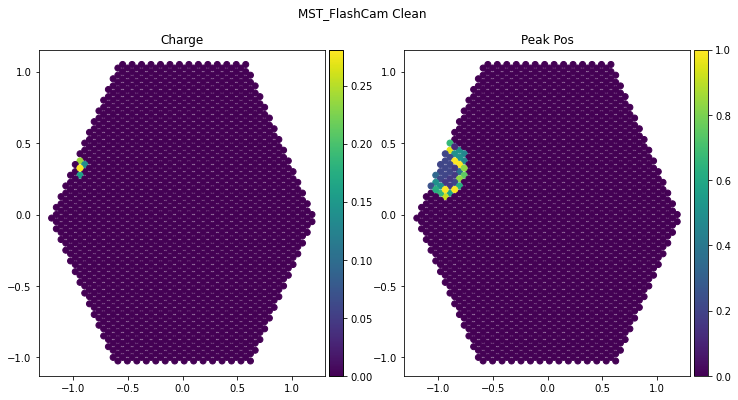

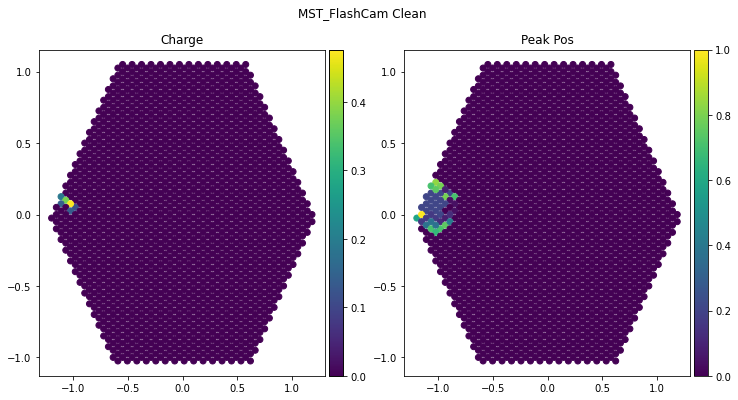

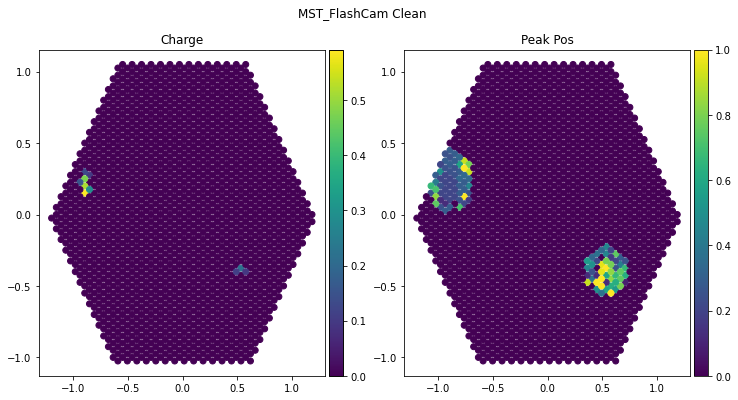

...

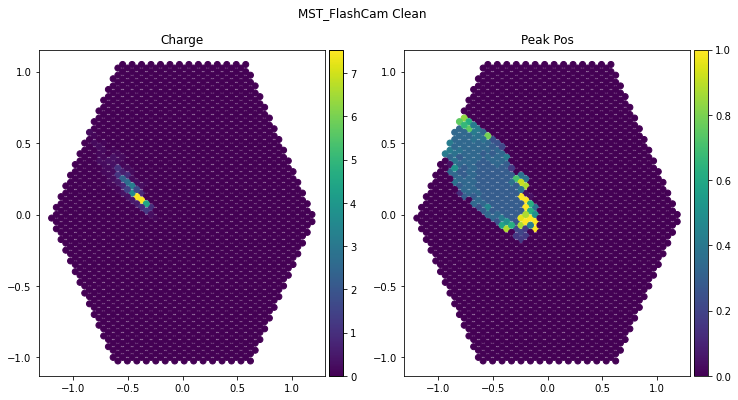

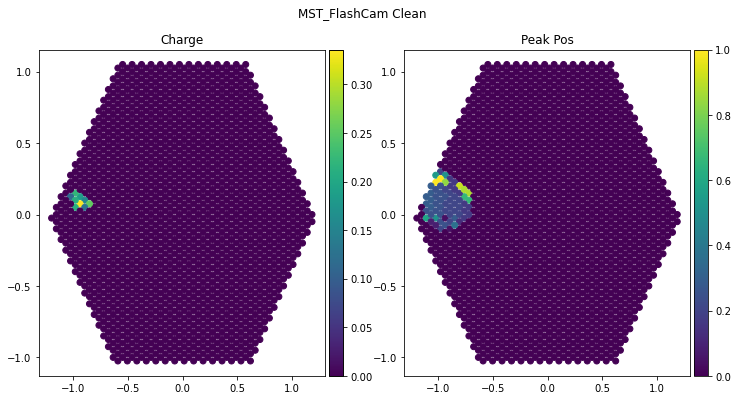

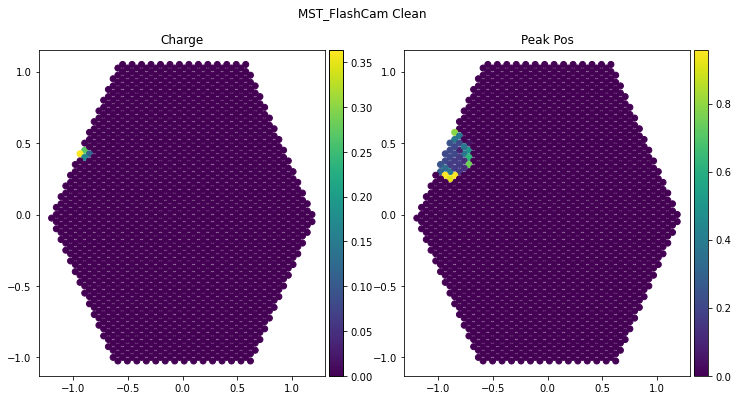

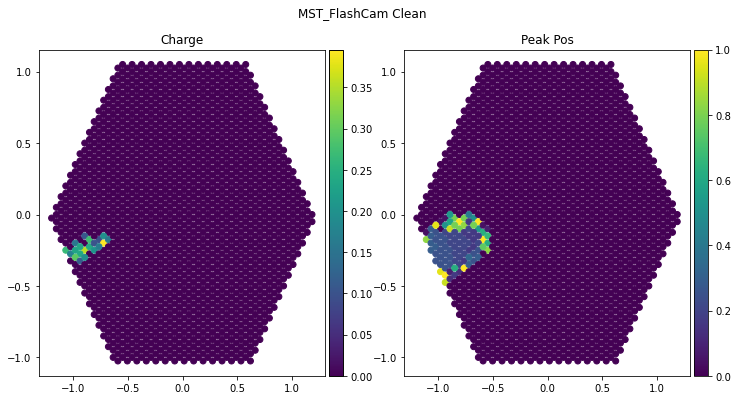

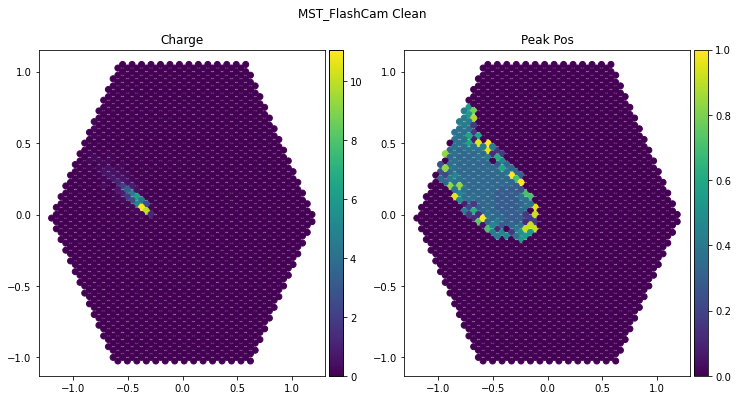

In [51]:
geometry = load_camera_geometry("MST_FlashCam",  version)
for i, d in enumerate(MST_generator):
    charge, peak = d[0][0][0]
    pixpos = PIXELS_POSITION[version]['raw']["MST_FlashCam"]
    cleanmask = tailcuts_clean(geometry, charge, picture_thresh=14, boundary_thresh=6)
    copy_charge = charge.copy()
    copy_charge[~cleanmask] = 0.0
    for _ in range(3):
        cleanmask = dilate(geometry, cleanmask)
    copy_peak = peak.copy()
    copy_peak[~cleanmask] = 0.0
    if i <= 15:
        plot_observation_scatter(copy_charge/mst_percentile, mst_scaler.transform(copy_peak.reshape((-1,1))).flatten(), pixpos, "MST_FlashCam Clean")

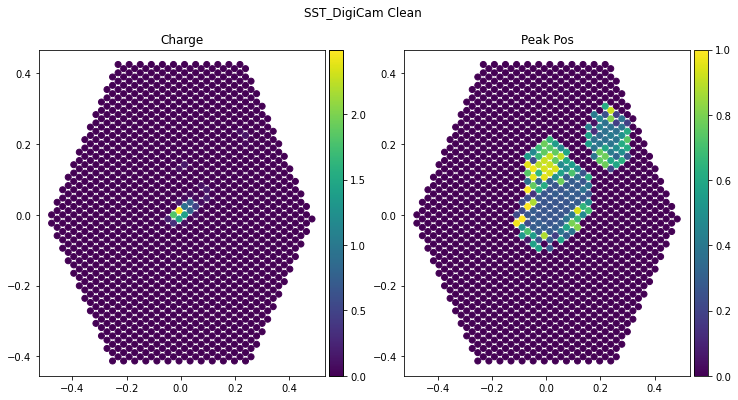

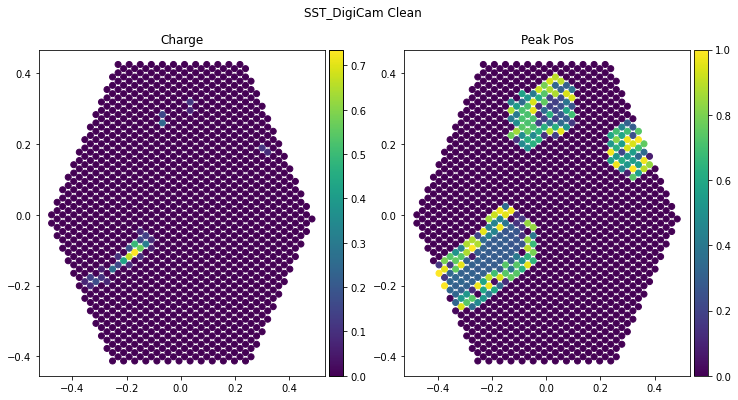

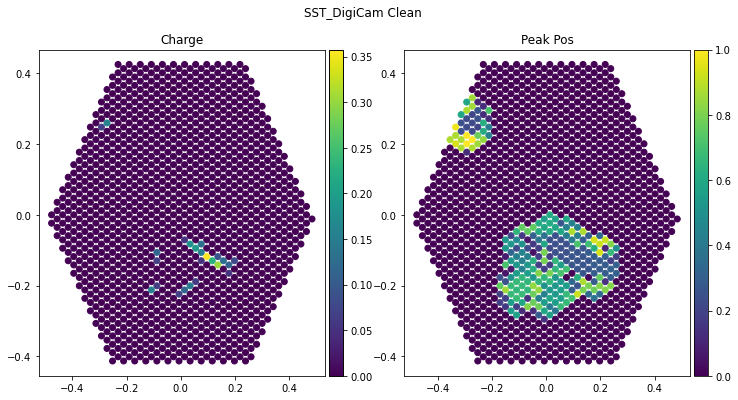

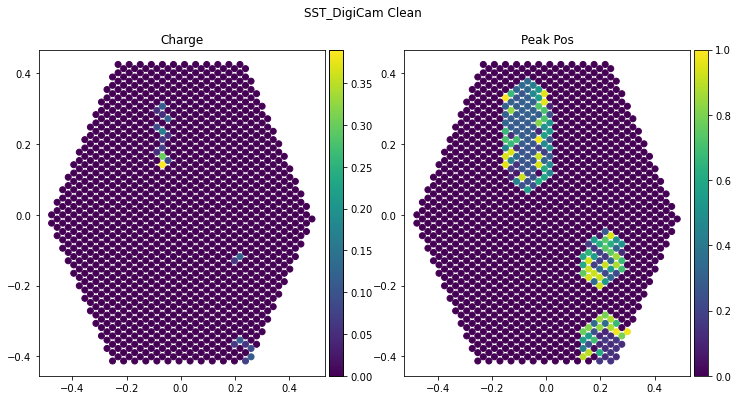

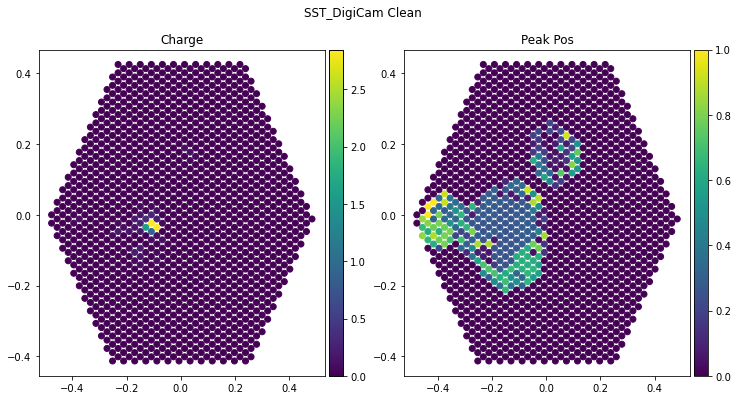

...

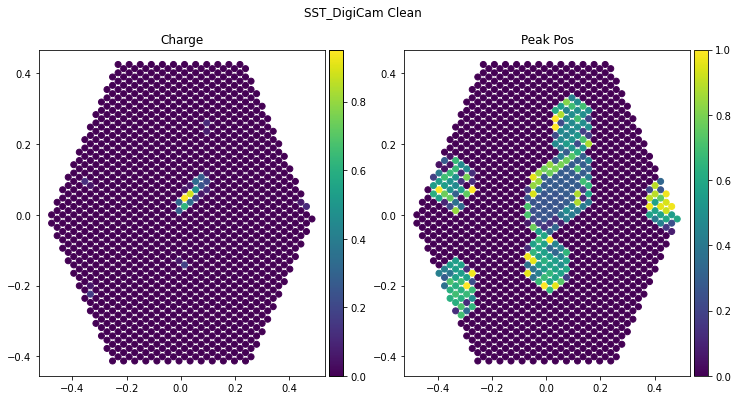

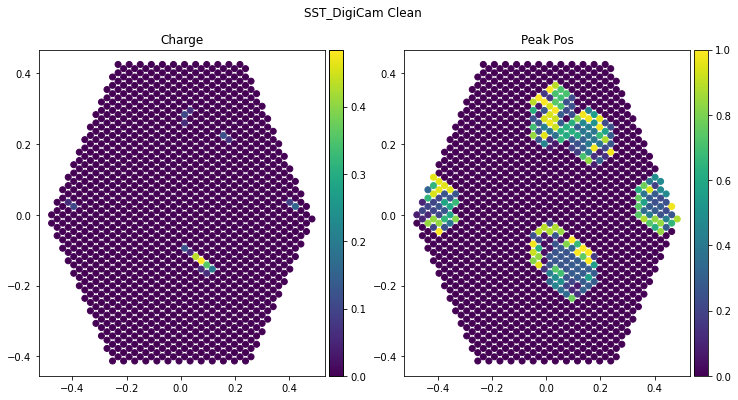

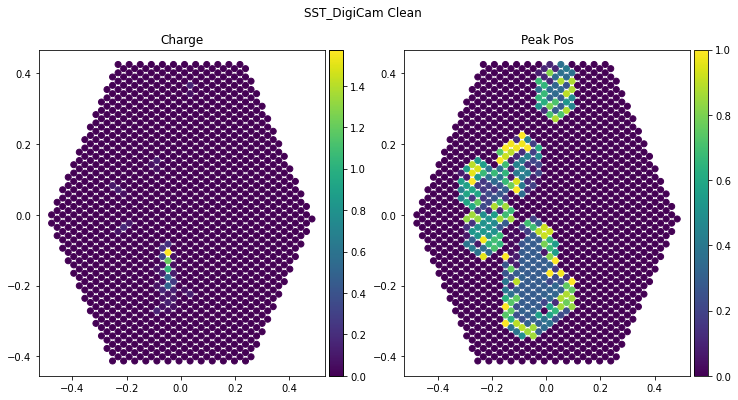

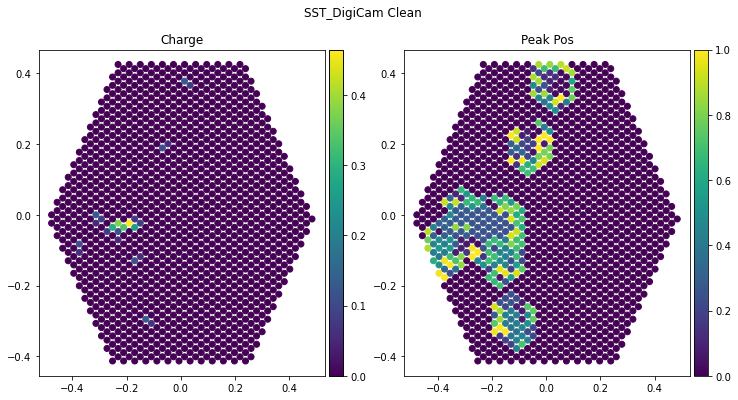

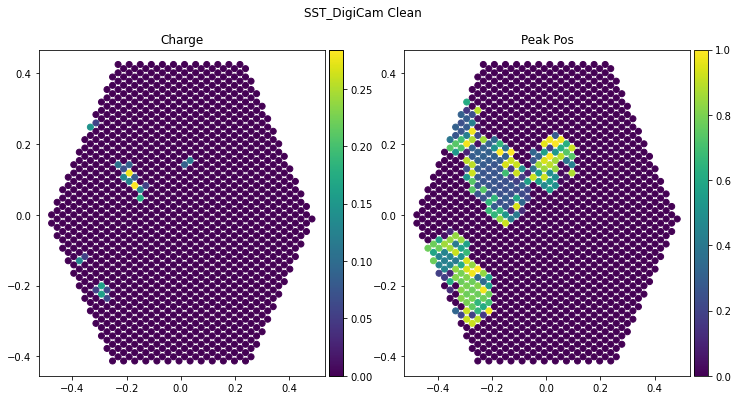

In [52]:
geometry = load_camera_geometry("SST1M_DigiCam",  version)
for i, d in enumerate(SST_generator):
    charge, peak = d[0][0][0]
    pixpos = PIXELS_POSITION[version]['raw']["SST1M_DigiCam"]
    cleanmask = tailcuts_clean(geometry, charge, picture_thresh=4, boundary_thresh=2)
    copy_charge = charge.copy()
    copy_charge[~cleanmask] = 0.0
    for _ in range(3):
        cleanmask = dilate(geometry, cleanmask)
    copy_peak = peak.copy()
    copy_peak[~cleanmask] = 0.0
    if i <= 15:
        plot_observation_scatter(copy_charge/sst_percentile, sst_scaler.transform(copy_peak.reshape((-1,1))).flatten(), pixpos, "SST_DigiCam Clean")

## Telescope Features: MinMaxScaler

In [53]:
telescope_position = train_dataset[['x', 'y']]
array_scaler = MinMaxScaler(feature_range=[-1,1]).fit(telescope_position)
array_scaler

MinMaxScaler(feature_range=[-1, 1])

In [54]:
telescope_position.iloc[0].values

array([-20.,  65.])

In [55]:
array_scaler.transform(telescope_position.iloc[0].values.reshape((-1,2)))

array([[-0.01672263,  0.05857254]])

# Parameters Results

In [56]:
dump(sst_scaler, f"{version}_SST1M_DigiCam_peak_scaler.gz")
dump(mst_scaler, f"{version}_MST_FlashCam_peak_scaler.gz")
dump(lst_scaler, f"{version}_LST_LSTCam_peak_scaler.gz");
dump(array_scaler, f"{version}_array-scaler.gz")

charge_scaler = {
    "SST1M_DigiCam": sst_percentile,
    "MST_FlashCam":  mst_percentile,
    "LST_LSTCam": lst_percentile,
}

print("charge scalers")
pprint.pprint(charge_scaler)

print("tails cut")
pprint.pprint(tailcuts_clean_parameters)

charge scalers
{'LST_LSTCam': 36.852122955322265,
 'MST_FlashCam': 64.38580017089845,
 'SST1M_DigiCam': 39.223409118652356}
tails cut
{'LST_LSTCam': {'boundary_thresh': 3, 'picture_thresh': 5},
 'MST_FlashCam': {'boundary_thresh': 6, 'picture_thresh': 14},
 'SST_DigiCam': {'boundary_thresh': 2, 'picture_thresh': 4}}
